In [1]:
import os
import shutil
import re
import os
import csv
import shutil
# from google.colab import drive
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
import pywt

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import spkit
print('spkit-version ', spkit.__version__)
import spkit as sp
from spkit.core.cwt import *


spkit-version  0.0.9.6.7


In [3]:
import os
import shutil
import random

In [4]:
channel_names=['Fp2', 'F8', 'T4', 'T6', 'O2', 'Fp1', 'F7', 'T3', 'T5', 'O1', 'F4', 'C4', 'P4', 'F3', 'C3', 'P3', 'Fz', 'Cz', 'Pz']

In [5]:
scalo_img_folder_path_not_healthy='F:/Research_24/PKS/Arghashryee/Repod_scalo_images'
os.makedirs(scalo_img_folder_path_not_healthy, exist_ok=True)

In [6]:
folder_path='C:/Users/Utathya/Downloads/RepOD_work/'
files = os.listdir(folder_path)
files

['h14.csv']

In [16]:
# {folder_path[9:12]}_{csv_file[:-4]}"

In [7]:
files[0][:-4]

'h14'

In [8]:
scalo_folder=f"{files[0][:-4]}"
scalo_folder_path=os.path.join(scalo_img_folder_path_not_healthy, scalo_folder)
scalo_folder_path

'F:/Research_24/PKS/Arghashryee/Repod_scalo_images\\h14'

In [19]:
15*60*250

225000

1
1


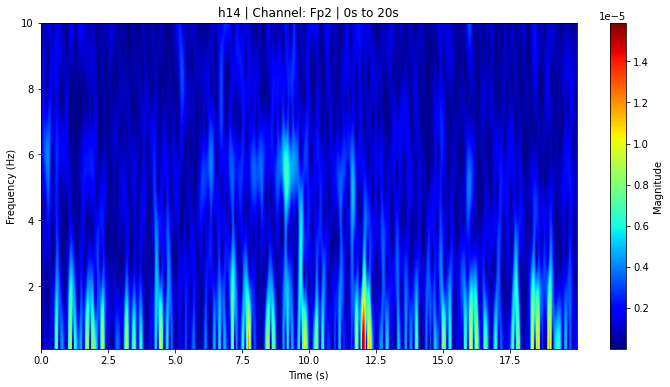

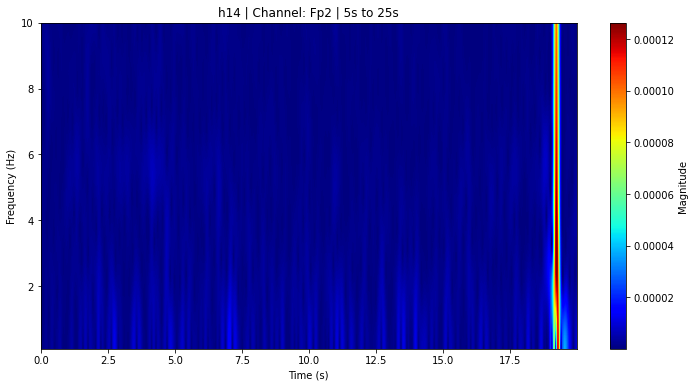

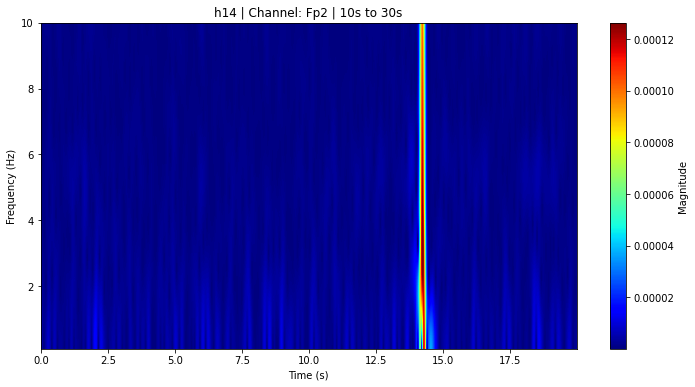

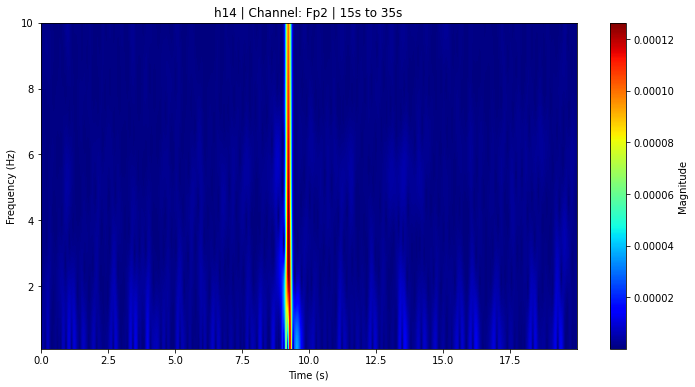

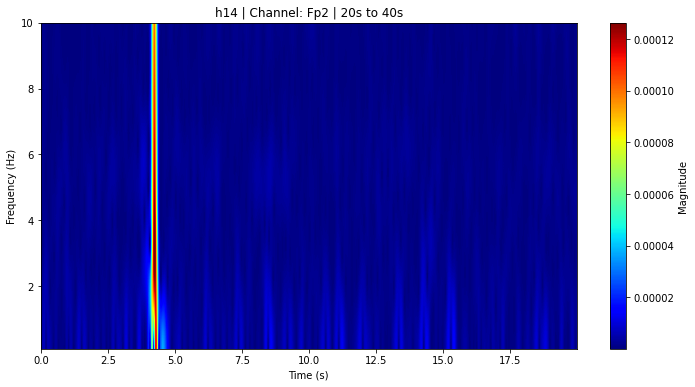

...

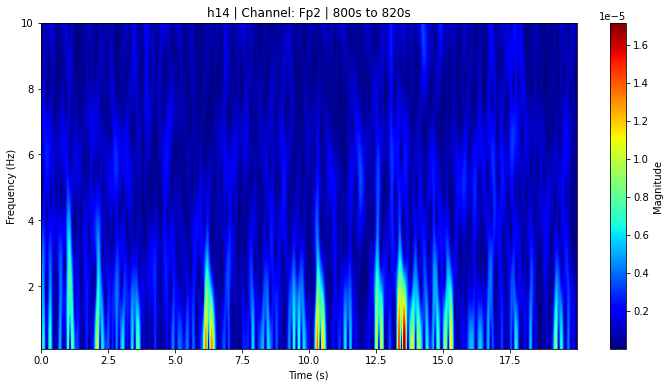

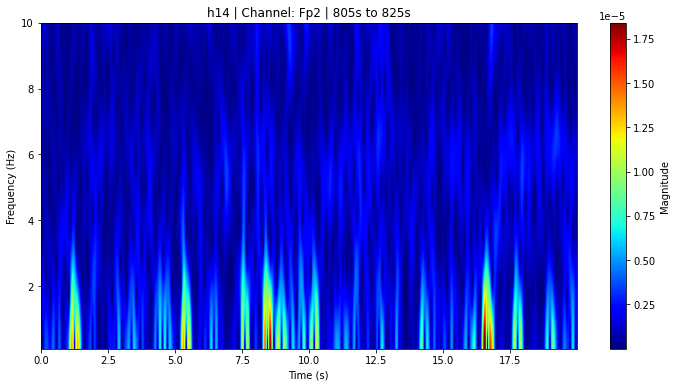

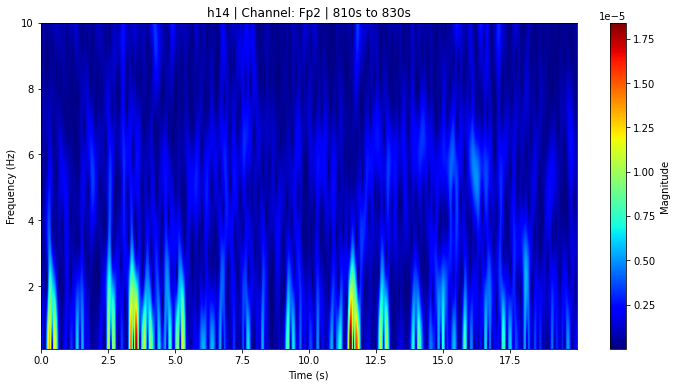

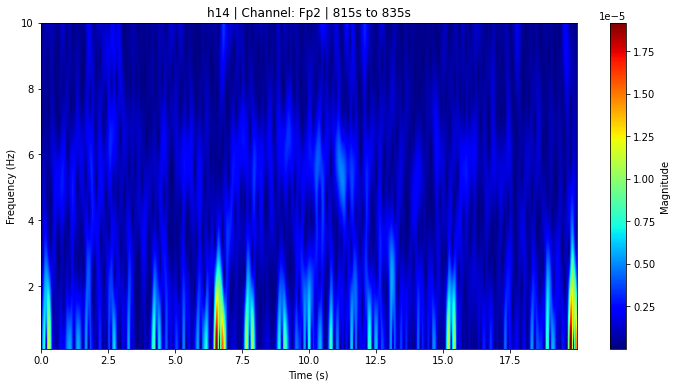

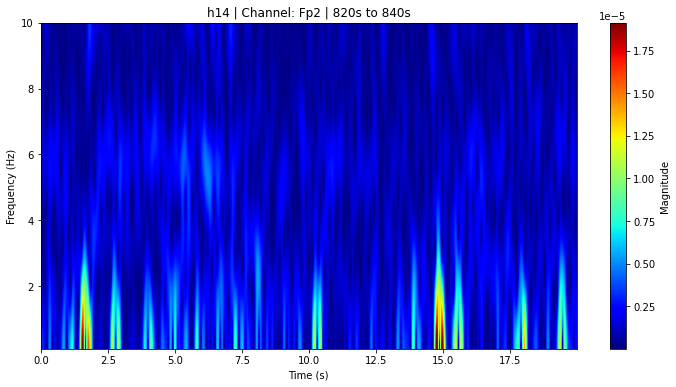



166


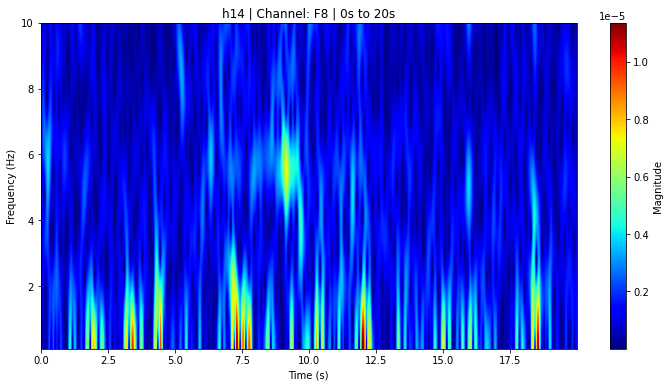

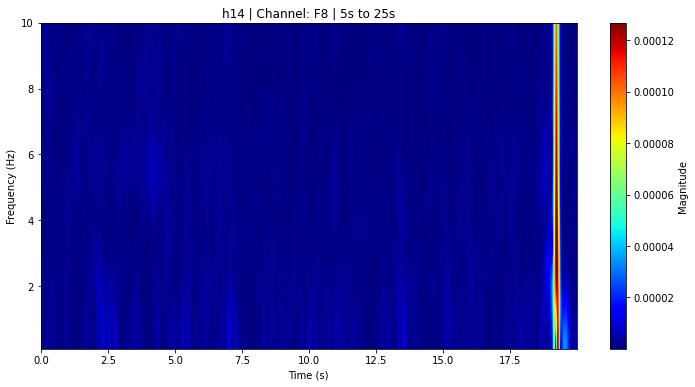

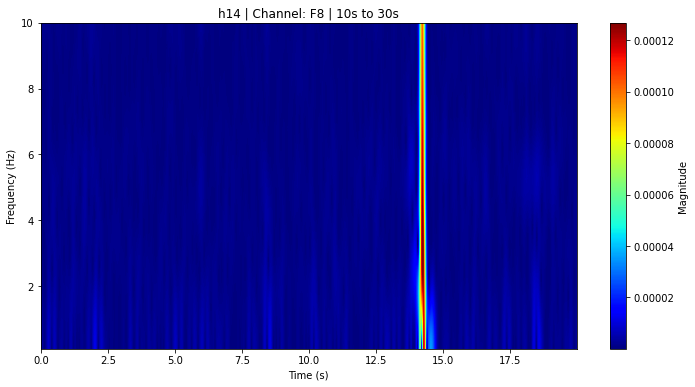

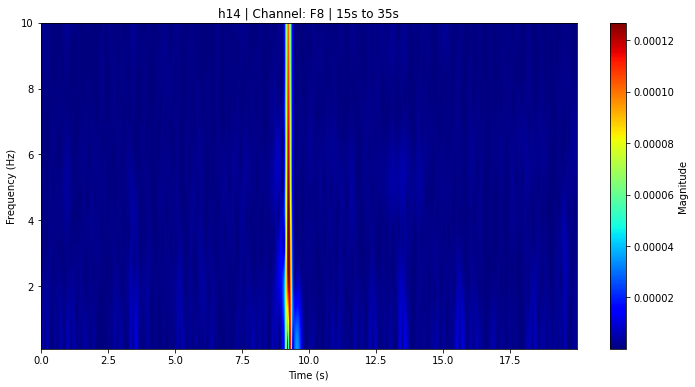

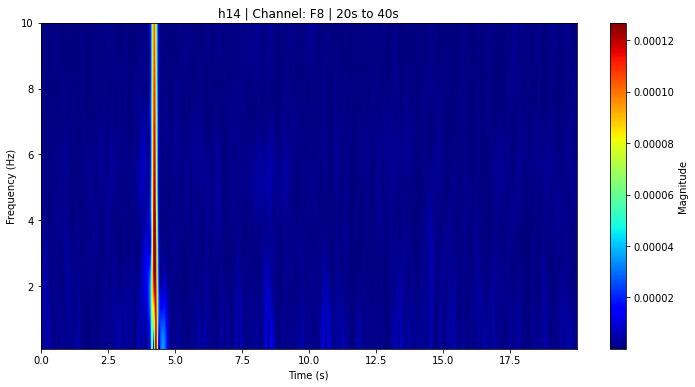

...

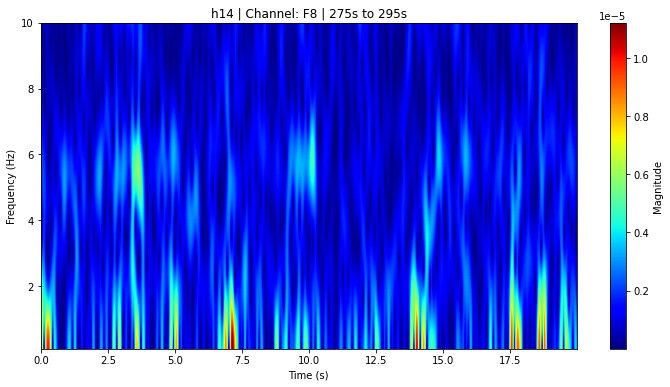

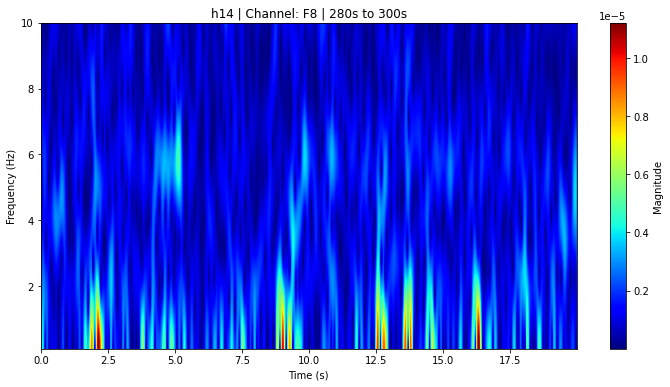

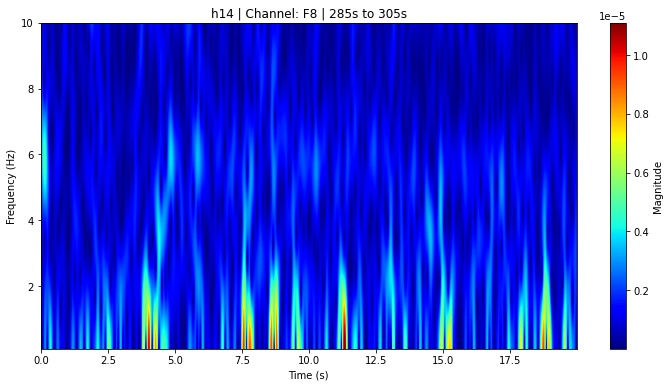

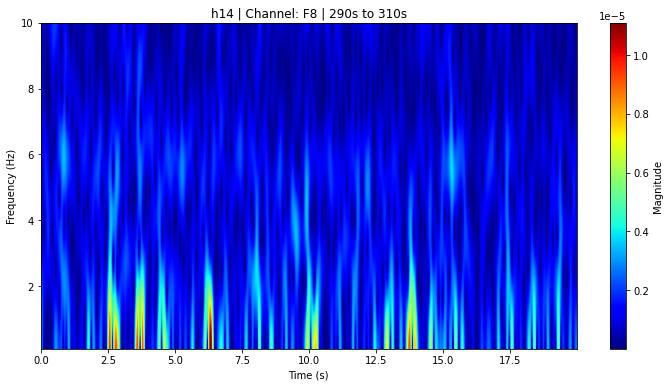

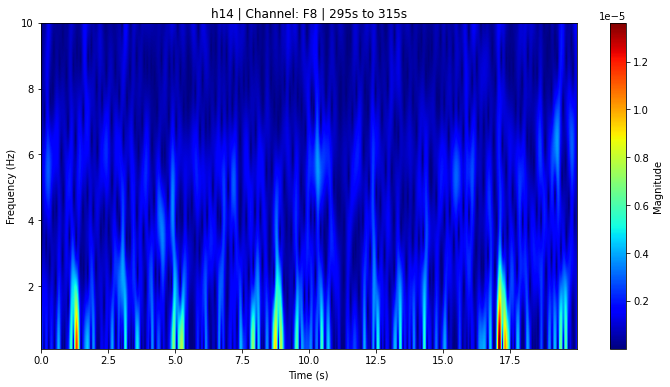

KeyboardInterrupt: 

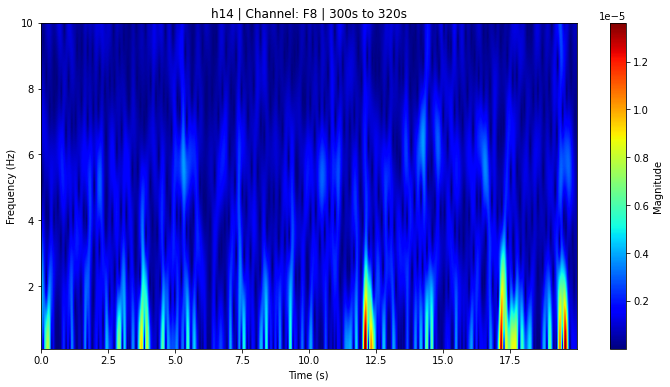

In [15]:
#for 20 seconds gap
folder_path='C:/Users/Utathya/Downloads/RepOD_work/'
import os
import pandas as pd
# x=[]
#frequency
fs=250
scalo_image=1
def read_csv_files_in_folder(folder_path,scalo_image):
    # Get a list of all files in the folder
    files = os.listdir(folder_path)
    # Filter only CSV files
    csv_files = [file for file in files if file.endswith('.csv')]
    t_image=1
    # Iterate through each CSV file and read it into a DataFrame
    k=210000
    for csv_file in csv_files:
        print(t_image)
        file_path = os.path.join(folder_path, csv_file)
        df = pd.read_csv(file_path)
        for i in range(len(channel_names)):
            print(scalo_image)
            column_values = df[channel_names[i]].tolist()
            start=0*250
            while start<k:
                end=start+(20*250)
                if end<=k:
                    # print(start,end)
                    second_values=column_values[start:end]
                    scalo_folder=f"{csv_file[:-4]}"
                    scalo_folder_path=os.path.join(scalo_img_folder_path_not_healthy, scalo_folder)
                    os.makedirs(scalo_folder_path, exist_ok=True)
                    start_sec=start//250
                    end_sec=end//250
                    scalo_plot_name=f"{csv_file[:-4]}_{channel_names[i]}_from_{start_sec}_{end_sec}_second"
                    # print(scalo_plot_name)
                    # x.append(scalo_plot_name)
                    t = np.arange(len(second_values))/fs
                    x=np.asarray(second_values)
                # print(x.shape, t.shape)
                # compare_cwt_example(x,t,fs)
                    f0 = np.linspace(0.1,10,100)
                    Q  = np.linspace(0.1,5,100)
                    XW,S = ScalogramCWT(x,t,fs=fs,wType='Morlet',fftMeth=True,f0=f0,Q=Q)
                    plt.figure(figsize=(12,6))
                    img=plt.imshow(np.abs(XW),aspect='auto',origin='lower',cmap='jet',extent=[t[0], t[-1], S[0], S[-1]],interpolation='sinc')
#                     plt.axis('off')
                    scalo_png_name = scalo_plot_name + '.png'
#                     save_path = os.path.join(scalo_folder_path, scalo_png_name)
#                     plt.savefig(save_path, format='png', bbox_inches='tight', pad_inches=0, dpi=100)
#                     plt.savefig(save_path, format='png', bbox_inches='tight', pad_inches=0, dpi=100)
                    scalo_image+=1
                    plt.xlabel("Time (s)")
                    plt.ylabel("Frequency (Hz)")
                    plt.title(f"{csv_file[:-4]} | Channel: {channel_names[i]} | {start//fs}s to {end//fs}s")
                    plt.colorbar(img, label='Magnitude')  
                    # Save image (uncomment if needed)
                    scalo_folder = f"{csv_file[:-4]}"
                    scalo_folder_path = os.path.join(scalo_img_folder_path_not_healthy, scalo_folder)
                    os.makedirs(scalo_folder_path, exist_ok=True)
                    scalo_plot_name = f"{csv_file[:-4]}_{channel_names[i]}_from_{start//fs}_{end//fs}_second_new.png"
                    save_path = os.path.join(scalo_folder_path, scalo_plot_name)
                    plt.savefig(save_path, format='png', bbox_inches='tight', pad_inches=0, dpi=100)

                    plt.show()
                    plt.close()
#                     break
                    print("\n")
                    # print()
                start+=(5*250)
            t_image+=1
read_csv_files_in_folder(folder_path,scalo_image)




In [ ]:
import PIL.Image

# Open the saved image
saved_image = PIL.Image.open(save_path)

# Get the resolution (width and height) of the image
width, height = saved_image.size

print(f"Resolution of the saved image: {width}x{height} pixels")
